# Import packages and modules

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.feature_selection import VarianceThreshold
import seaborn as sns
import numpy as np
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score

# Load dataset

In [2]:
data = pd.read_csv('prediktiv_data.csv')
print(len (data))
print(data.head())

2930
   id  target  feature01  feature02  feature03  feature04  feature05  \
0   1  215000        2.0      528.0          0     1080.0       1656   
1   2  105000        1.0      730.0          0      882.0        896   
2   3  172000        1.0      312.0          0     1329.0       1329   
3   4  244000        2.0      522.0          0     2110.0       2110   
4   5  189900        2.0      482.0          0      928.0        928   

   feature06  feature07  feature08  ...  feature14  feature15  feature16  \
0          7       1656          6  ...          2       good        bad   
1          5        896          5  ...          0        NaN        bad   
2          6       1329          6  ...          0        NaN       good   
3          8       2110          7  ...          2        bad    amazing   
4          6       1629          5  ...          1        bad        bad   

  feature17 feature18 feature19  feature20 feature21 feature22  feature23  
0         3         1        

# Check the shape of the dataframe and Description statistics

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2930 entries, 0 to 2929
Data columns (total 26 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           2930 non-null   int64  
 1   target       2930 non-null   int64  
 2   feature01    2929 non-null   float64
 3   feature02    2929 non-null   float64
 4   feature03    2930 non-null   int64  
 5   feature04    2929 non-null   float64
 6   feature05    2930 non-null   int64  
 7   feature06    2930 non-null   int64  
 8   feature07    2930 non-null   int64  
 9   feature08    2930 non-null   int64  
 10  feature09    2930 non-null   int64  
 11  feature10    2930 non-null   int64  
 12  feature10.1  2930 non-null   int64  
 13  feature11    198 non-null    object 
 14  feature12    572 non-null    object 
 15  feature13    2929 non-null   object 
 16  feature14    2930 non-null   int64  
 17  feature15    1508 non-null   object 
 18  feature16    2930 non-null   object 
 19  featur

In [4]:
data.shape

(2930, 26)

In [5]:
# Statical view of data set
data.describe()

,id,target,feature01,feature02,feature03,feature04,feature05,feature06,feature07,feature08,...,feature10,feature10.1,feature14,feature17,feature18,feature19,feature20,feature21,feature22,feature23
count,2930.00000,2930.000000,2929.000000,2929.000000,2930.000000,2929.000000,2930.000000,2930.000000,2930.000000,2930.000000,...,2930.000000,2930.000000,2930.000000,2930.000000,2930.000000,2930.000000,2930.000000,2930.000000,2930.000000,2930.000000
mean,1465.50000,180796.060068,1.766815,472.819734,2.243345,1051.614544,1159.557679,6.443003,1499.690444,6.094881,...,1971.356314,1.566553,0.599317,2.854266,1.044369,6.216041,2007.790444,0.379522,335.455973,1984.266553
std,845.96247,79886.692357,0.760566,215.046549,35.597181,440.615067,391.890885,1.572964,505.508887,1.411026,...,30.245361,0.552941,0.647921,0.827731,0.214076,2.714492,1.316613,0.502629,428.395715,20.860286
min,1.00000,12789.000000,0.000000,0.000000,0.000000,0.000000,334.000000,2.000000,334.000000,1.000000,...,1872.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,0.000000,0.000000,1950.000000
25%,733.25000,129500.000000,1.000000,320.000000,0.000000,793.000000,876.250000,5.000000,1126.000000,5.000000,...,1954.000000,1.000000,0.000000,2.000000,1.000000,4.000000,2007.000000,0.000000,0.000000,1965.000000
50%,1465.50000,160000.000000,2.000000,480.000000,0.000000,990.000000,1084.000000,6.000000,1442.000000,6.000000,...,1973.000000,2.000000,1.000000,3.000000,1.000000,6.000000,2008.000000,0.000000,0.000000,1993.000000
75%,2197.75000,213500.000000,2.000000,576.000000,0.000000,1302.000000,1384.000000,7.000000,1742.750000,7.000000,...,2001.000000,2.000000,1.000000,3.000000,1.000000,8.000000,2009.000000,1.000000,703.750000,2004.000000
max,2930.00000,755000.000000,5.000000,1488.000000,800.000000,6110.000000,5095.000000,15.000000,5642.000000,10.000000,...,2010.000000,4.000000,4.000000,8.000000,3.000000,12.000000,2010.000000,2.000000,2065.000000,2010.000000


In [6]:
# TO SEE ALL COLUMN NAMES
data.keys()

Index(['id', 'target', 'feature01', 'feature02', 'feature03', 'feature04',
       'feature05', 'feature06', 'feature07', 'feature08', 'feature09',
       'feature10', 'feature10.1', 'feature11', 'feature12', 'feature13',
       'feature14', 'feature15', 'feature16', 'feature17', 'feature18',
       'feature19', 'feature20', 'feature21', 'feature22', 'feature23'],
      dtype='object')

In [7]:
# HOW MANY UNIQUE VALUE HAVE 
data.nunique()

id             2930
target         1032
feature01         6
feature02       603
feature03        14
feature04      1058
feature05      1083
feature06        14
feature07      1292
feature08        10
feature09         9
feature10       118
feature10.1       5
feature11         2
feature12         4
feature13         5
feature14         5
feature15         5
feature16         5
feature17         8
feature18         4
feature19        12
feature20         5
feature21         3
feature22       635
feature23        61
dtype: int64

Gaining information of checking all column by groupby here is some example

In [8]:
data.groupby('feature01')['feature01'].agg('count')

feature01
0.0     157
1.0     778
2.0    1603
3.0     374
4.0      16
5.0       1
Name: feature01, dtype: int64

In [9]:
data.groupby('feature16')['feature16'].agg('count')

feature16
amazing      205
bad         1494
good        1160
horrible       1
okay          70
Name: feature16, dtype: int64

# Scatterplot for finding relationship with target variable some important plot

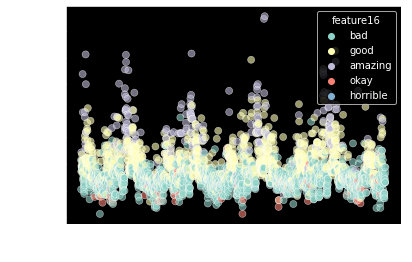

In [10]:
sns.scatterplot(x='id', y='target',hue='feature16',data=data,s=50,alpha=0.6);

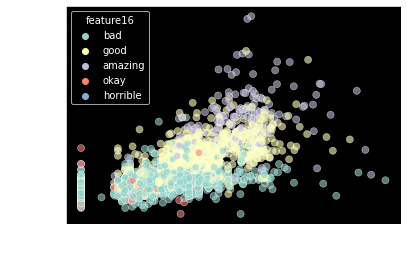

In [11]:
sns.scatterplot(x='feature02', y='target',hue='feature16',data=data,s=50,alpha=0.6);

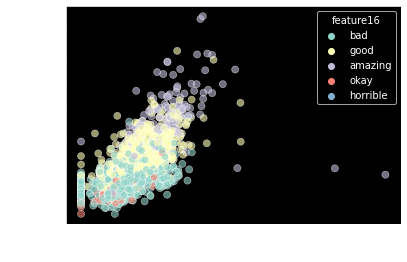

In [12]:
sns.scatterplot(x='feature04', y='target',hue='feature16',data=data,s=50,alpha=0.6);

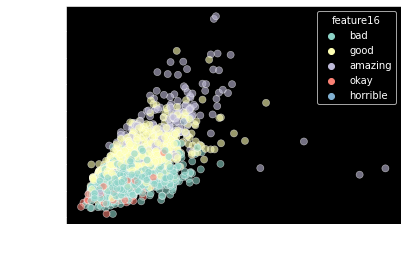

In [13]:
sns.scatterplot(x='feature05', y='target',hue='feature16',data=data,s=50,alpha=0.6);

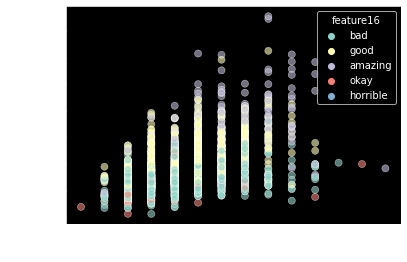

In [14]:
sns.scatterplot(x='feature06', y='target',hue='feature16',data=data,s=50,alpha=0.6);

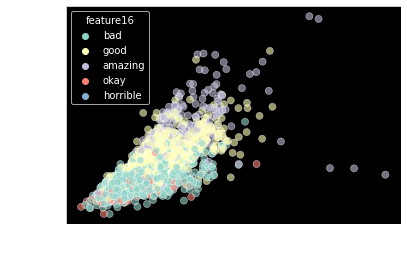

In [15]:
sns.scatterplot(x='feature07', y='target',hue='feature16',data=data,s=50,alpha=0.6);

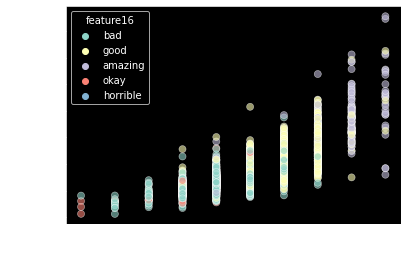

In [16]:
sns.scatterplot(x='feature08', y='target',hue='feature16',data=data,s=50,alpha=0.6);

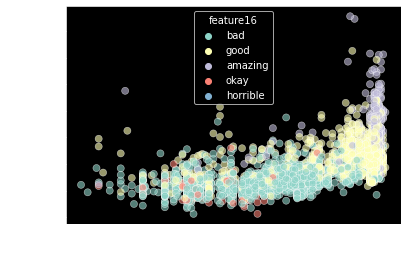

In [17]:
sns.scatterplot(x='feature10', y='target',hue='feature16',data=data,s=50,alpha=0.6);

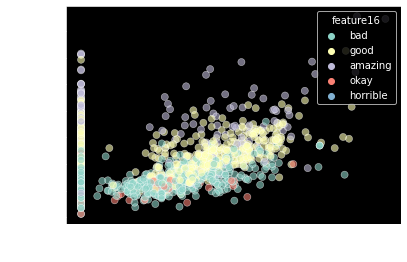

In [18]:
sns.scatterplot(x='feature22', y='target',hue='feature16',data=data,s=50,alpha=0.6);

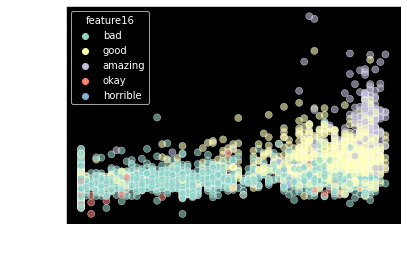

In [19]:
sns.scatterplot(x='feature23', y='target',hue='feature16',data=data,s=50,alpha=0.6);

After checking all feature find some important co_related feature it shows in pairplot

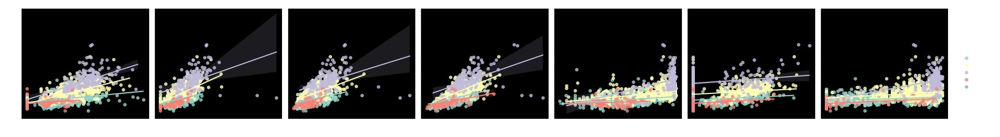

In [20]:
sns.pairplot(data,
             hue='feature16',
             y_vars=['target'],
             x_vars=['feature02','feature04','feature05','feature07','feature10','feature22','feature23'],
             kind='reg',
             height=4);

# Nan Value

In [21]:
# Number of Nan Value
missing = data.isnull().sum()
print(missing)

id                0
target            0
feature01         1
feature02         1
feature03         0
feature04         1
feature05         0
feature06         0
feature07         0
feature08         0
feature09         0
feature10         0
feature10.1       0
feature11      2732
feature12      2358
feature13         1
feature14         0
feature15      1422
feature16         0
feature17         0
feature18         0
feature19         0
feature20         0
feature21         0
feature22         0
feature23         0
dtype: int64


In [22]:
# Showing all variables with mising values
misssing_data = missing[missing > 0 ]
misssing_data

feature01       1
feature02       1
feature04       1
feature11    2732
feature12    2358
feature13       1
feature15    1422
dtype: int64

In [23]:
# selecting all the columns with  large missing values
l_missing_data = misssing_data[misssing_data > 1]
l_missing_data

feature11    2732
feature12    2358
feature15    1422
dtype: int64

# Information of majority Nan value columns

In [24]:
data.groupby('feature11')['feature11'].agg('count')

feature11
Grvl    120
Pave     78
Name: feature11, dtype: int64

In [25]:
data.groupby('feature12')['feature12'].agg('count')

feature12
cat     118
cow     112
dog     330
frog     12
Name: feature12, dtype: int64

In [26]:
data.groupby('feature15')['feature15'].agg('count')

feature15
amazing      43
bad         600
good        744
horrible     46
okay         75
Name: feature15, dtype: int64

In [27]:
# Delating columns with majority of missing Value
remove_column = l_missing_data.index
data.drop(remove_column,axis=1, inplace=True)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2930 entries, 0 to 2929
Data columns (total 23 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           2930 non-null   int64  
 1   target       2930 non-null   int64  
 2   feature01    2929 non-null   float64
 3   feature02    2929 non-null   float64
 4   feature03    2930 non-null   int64  
 5   feature04    2929 non-null   float64
 6   feature05    2930 non-null   int64  
 7   feature06    2930 non-null   int64  
 8   feature07    2930 non-null   int64  
 9   feature08    2930 non-null   int64  
 10  feature09    2930 non-null   int64  
 11  feature10    2930 non-null   int64  
 12  feature10.1  2930 non-null   int64  
 13  feature13    2929 non-null   object 
 14  feature14    2930 non-null   int64  
 15  feature16    2930 non-null   object 
 16  feature17    2930 non-null   int64  
 17  feature18    2930 non-null   int64  
 18  feature19    2930 non-null   int64  
 19  featur

In [28]:
data.shape

(2930, 23)

Information about column have small amount of Nan Value

In [29]:
data.groupby('feature01')['feature01'].agg('count')

feature01
0.0     157
1.0     778
2.0    1603
3.0     374
4.0      16
5.0       1
Name: feature01, dtype: int64

In [30]:
data.groupby('feature02')['feature02'].agg('count')

feature02
0.0       157
100.0       1
160.0       3
162.0       2
164.0       2
         ... 
1348.0      1
1356.0      1
1390.0      1
1418.0      1
1488.0      1
Name: feature02, Length: 603, dtype: int64

In [31]:
data.groupby('feature04')['feature04'].agg('count')

feature04
0.0       79
105.0      1
160.0      1
173.0      1
190.0      1
          ..
3138.0     1
3200.0     1
3206.0     1
5095.0     1
6110.0     1
Name: feature04, Length: 1058, dtype: int64

In [32]:
data.groupby('feature13')['feature13'].agg('count')

feature13
blue       188
green       50
pink         1
red       2682
yellow       8
Name: feature13, dtype: int64

In [33]:
# Handle Nan Value
clean_data = data.fillna({
    'feature01': 0,
    'feature02': 0,
    'feature04': 0,
    'feature13': 'yellow'
})
clean_data.isnull().sum()

id             0
target         0
feature01      0
feature02      0
feature03      0
feature04      0
feature05      0
feature06      0
feature07      0
feature08      0
feature09      0
feature10      0
feature10.1    0
feature13      0
feature14      0
feature16      0
feature17      0
feature18      0
feature19      0
feature20      0
feature21      0
feature22      0
feature23      0
dtype: int64

In [34]:
# Showing How many Catecorical/object columns have
object_data = [object]
object_columns = list(clean_data.select_dtypes(include=object_data).columns)
object_columns

['feature13', 'feature16']

In [35]:
# Information about categorical columns feature13
clean_data.feature13

0       red
1       red
2       red
3       red
4       red
       ... 
2925    red
2926    red
2927    red
2928    red
2929    red
Name: feature13, Length: 2930, dtype: object

In [36]:
# More Information of feature13
clean_data.groupby('feature13')['feature13'].agg('count')

feature13
blue       188
green       50
pink         1
red       2682
yellow       9
Name: feature13, dtype: int64

In [37]:
# Information about categorical columns feature16
clean_data.feature16

0           bad
1           bad
2          good
3       amazing
4           bad
         ...   
2925        bad
2926        bad
2927        bad
2928        bad
2929        bad
Name: feature16, Length: 2930, dtype: object

In [38]:
# More Information of feature16
clean_data.groupby('feature16')['feature16'].agg('count')

feature16
amazing      205
bad         1494
good        1160
horrible       1
okay          70
Name: feature16, dtype: int64

## Creating Dummy Variable

In [39]:
# Using Dummy variable for categorical feature
clean_data = pd.concat([clean_data,pd.get_dummies(clean_data['feature13'],prefix='feature13',drop_first=True)],axis=1)
clean_data = pd.concat([clean_data,pd.get_dummies(clean_data['feature16'],prefix='feature16',drop_first=True)],axis=1)
clean_data.drop(['feature13','feature16'],axis=1, inplace=True)

In [40]:
# cleaning data info
clean_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2930 entries, 0 to 2929
Data columns (total 29 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  2930 non-null   int64  
 1   target              2930 non-null   int64  
 2   feature01           2930 non-null   float64
 3   feature02           2930 non-null   float64
 4   feature03           2930 non-null   int64  
 5   feature04           2930 non-null   float64
 6   feature05           2930 non-null   int64  
 7   feature06           2930 non-null   int64  
 8   feature07           2930 non-null   int64  
 9   feature08           2930 non-null   int64  
 10  feature09           2930 non-null   int64  
 11  feature10           2930 non-null   int64  
 12  feature10.1         2930 non-null   int64  
 13  feature14           2930 non-null   int64  
 14  feature17           2930 non-null   int64  
 15  feature18           2930 non-null   int64  
 16  featur

In [41]:
# All columns name
clean_data.keys()

Index(['id', 'target', 'feature01', 'feature02', 'feature03', 'feature04',
       'feature05', 'feature06', 'feature07', 'feature08', 'feature09',
       'feature10', 'feature10.1', 'feature14', 'feature17', 'feature18',
       'feature19', 'feature20', 'feature21', 'feature22', 'feature23',
       'feature13_green', 'feature13_pink', 'feature13_red',
       'feature13_yellow', 'feature16_bad', 'feature16_good',
       'feature16_horrible', 'feature16_okay'],
      dtype='object')

In [42]:
# Cleaning data shape
clean_data.shape

(2930, 29)

# Outliar remove by checking Boxplot and using IQR

<AxesSubplot:xlabel='target'>

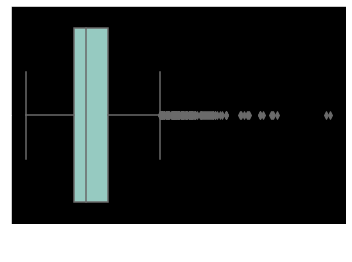

In [43]:
sns.boxplot(x=clean_data['target'])

In [44]:
first_quartile = clean_data['target'].quantile(.25)
third_quartile = clean_data['target'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['target']>new_boundary].index,axis=0,inplace=True)

In [45]:
clean_data.shape

(2904, 29)

<AxesSubplot:xlabel='feature02'>

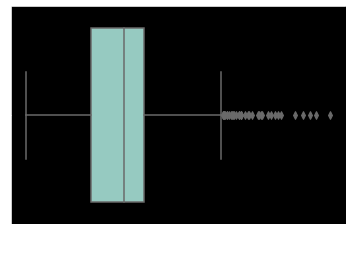

In [46]:
sns.boxplot(x=clean_data['feature02'])

In [47]:
first_quartile = clean_data['feature02'].quantile(.25)
third_quartile = clean_data['feature02'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature02']>new_boundary].index,axis=0,inplace=True)

In [48]:
clean_data.shape

(2900, 29)

<AxesSubplot:xlabel='feature03'>

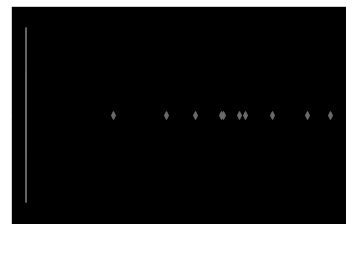

In [49]:
sns.boxplot(x=clean_data['feature03'])

In [50]:
first_quartile = clean_data['feature03'].quantile(.25)
third_quartile = clean_data['feature03'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature03']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature04'>

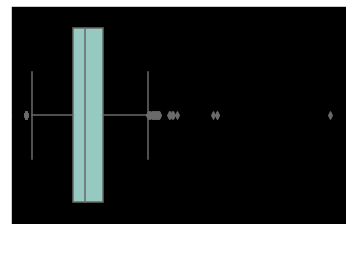

In [51]:
sns.boxplot(x=clean_data['feature04'])

In [52]:
first_quartile = clean_data['feature04'].quantile(.25)
third_quartile = clean_data['feature04'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature04']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature05'>

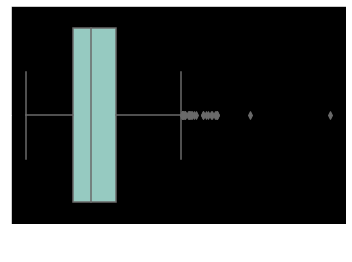

In [53]:
sns.boxplot(x=clean_data['feature05'])

In [54]:
first_quartile = clean_data['feature05'].quantile(.25)
third_quartile = clean_data['feature05'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature05']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature06'>

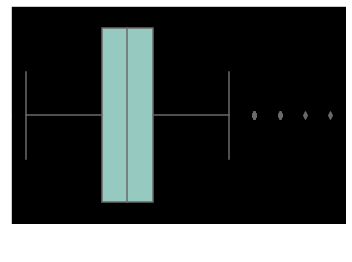

In [55]:
sns.boxplot(x=clean_data['feature06'])

In [56]:
first_quartile = clean_data['feature06'].quantile(.25)
third_quartile = clean_data['feature06'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature06']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature07'>

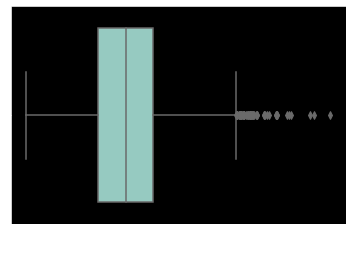

In [57]:
sns.boxplot(x=clean_data['feature07'])

In [58]:
first_quartile = clean_data['feature07'].quantile(.25)
third_quartile = clean_data['feature07'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature07']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature18'>

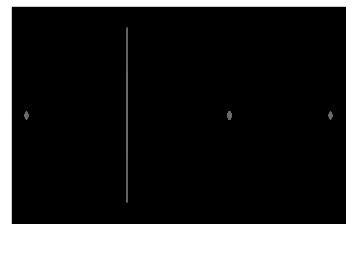

In [59]:
sns.boxplot(x=clean_data['feature18'])

In [60]:
first_quartile = clean_data['feature18'].quantile(.25)
third_quartile = clean_data['feature18'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature18']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature13_green'>

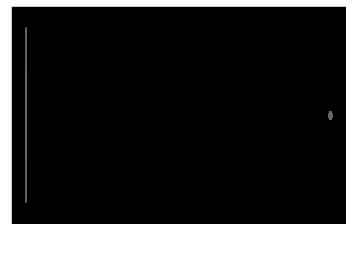

In [61]:
sns.boxplot(x=clean_data['feature13_green'])

In [62]:
first_quartile = clean_data['feature13_green'].quantile(.25)
third_quartile = clean_data['feature13_green'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature13_green']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature13_pink'>

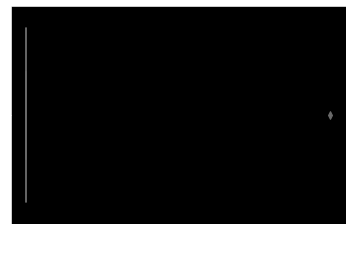

In [63]:
sns.boxplot(x=clean_data['feature13_pink'])

In [64]:
first_quartile = clean_data['feature13_pink'].quantile(.25)
third_quartile = clean_data['feature13_pink'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature13_pink']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature13_yellow'>

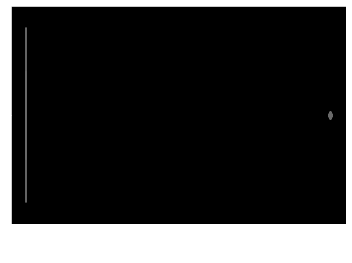

In [65]:
sns.boxplot(x=clean_data['feature13_yellow'])

In [66]:
first_quartile = clean_data['feature13_yellow'].quantile(.25)
third_quartile = clean_data['feature13_yellow'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature13_yellow']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature16_horrible'>

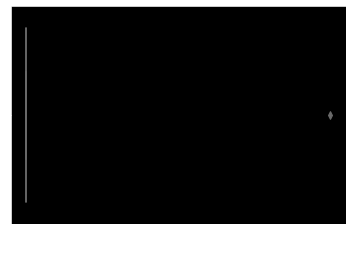

In [67]:
sns.boxplot(x=clean_data['feature16_horrible'])

In [68]:
first_quartile = clean_data['feature16_horrible'].quantile(.25)
third_quartile = clean_data['feature16_horrible'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature16_horrible']>new_boundary].index,axis=0,inplace=True)

<AxesSubplot:xlabel='feature16_okay'>

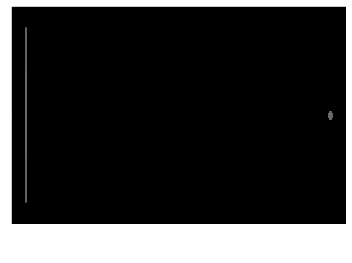

In [69]:
sns.boxplot(x=clean_data['feature16_okay'])

In [70]:
first_quartile = clean_data['feature16_okay'].quantile(.25)
third_quartile = clean_data['feature16_okay'].quantile(.75)
IQR = third_quartile - first_quartile
new_boundary = third_quartile + 3 *IQR
clean_data.drop(clean_data[clean_data['feature16_okay']>new_boundary].index,axis=0,inplace=True)

In [71]:
clean_data.shape

(2654, 29)

# Removing Low varience Feature

In [72]:
### It will zero variance features
low_variance=VarianceThreshold(threshold=0.0)
low_variance.fit(clean_data)

VarianceThreshold()

In [73]:
low_variance.get_support()

array([ True,  True,  True,  True, False,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False, False,  True, False,  True,  True,
       False, False])

In [74]:
clean_data.columns[low_variance.get_support()]

Index(['id', 'target', 'feature01', 'feature02', 'feature04', 'feature05',
       'feature06', 'feature07', 'feature08', 'feature09', 'feature10',
       'feature10.1', 'feature14', 'feature17', 'feature18', 'feature19',
       'feature20', 'feature21', 'feature22', 'feature23', 'feature13_red',
       'feature16_bad', 'feature16_good'],
      dtype='object')

In [75]:
# Find non_constant features
len(clean_data.columns[low_variance.get_support()])

23

In [76]:
# count the number of constant features
constant_columns = [column for column in clean_data.columns
                    if column not in clean_data.columns[low_variance.get_support()]]

print(len(constant_columns))

6


In [77]:
# Find constant features§
for feature in constant_columns:
     print(feature)

feature03
feature13_green
feature13_pink
feature13_yellow
feature16_horrible
feature16_okay


In [78]:
# Droping the low variance features
clean_data = clean_data.drop(constant_columns,axis=1)

In [79]:
# New data columns names
clean_data.keys()

Index(['id', 'target', 'feature01', 'feature02', 'feature04', 'feature05',
       'feature06', 'feature07', 'feature08', 'feature09', 'feature10',
       'feature10.1', 'feature14', 'feature17', 'feature18', 'feature19',
       'feature20', 'feature21', 'feature22', 'feature23', 'feature13_red',
       'feature16_bad', 'feature16_good'],
      dtype='object')

In [80]:
# New data shape
clean_data.shape

(2654, 23)

In [81]:
clean_data.groupby('feature16_good')['feature16_good'].agg('count')

feature16_good
0    1516
1    1138
Name: feature16_good, dtype: int64

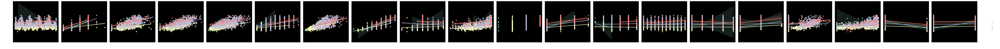

In [82]:
sns.pairplot(clean_data,
             hue='feature10.1',
             y_vars=['target'],
             x_vars=['id','feature01','feature02','feature04','feature05','feature06',
                     'feature07','feature08','feature09','feature10','feature10.1',
                     'feature14','feature17','feature19','feature20','feature21',
                     'feature22','feature23','feature16_bad','feature16_good'],
             kind='reg',
             height=4);

# Dividing the data for train and test sets

In [83]:
clean_data.target.value_counts()

140000    31
135000    29
155000    27
130000    24
145000    21
          ..
159895     1
187687     1
217300     1
226750     1
71000      1
Name: target, Length: 952, dtype: int64

In [84]:
X = clean_data.drop('target', axis=1)
y = clean_data['target']

In [85]:
X.head()

,id,feature01,feature02,feature04,feature05,feature06,feature07,feature08,feature09,feature10,...,feature17,feature18,feature19,feature20,feature21,feature22,feature23,feature13_red,feature16_bad,feature16_good
0,1,2.0,528.0,1080.0,1656,7,1656,6,5,1960,...,3,1,5,2010,0,0,1960,1,1,0
1,2,1.0,730.0,882.0,896,5,896,5,6,1961,...,2,1,6,2010,0,0,1961,1,1,0
2,3,1.0,312.0,1329.0,1329,6,1329,6,6,1958,...,3,1,6,2010,1,0,1958,1,0,1
3,4,2.0,522.0,2110.0,2110,8,2110,7,5,1968,...,3,1,4,2010,1,0,1968,1,0,0
4,5,2.0,482.0,928.0,928,6,1629,5,5,1997,...,3,1,3,2010,1,701,1998,1,1,0


Deviding the data by using train_test_split

In [86]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=123)
X_train.shape, X_test.shape

((1857, 22), (797, 22))

### Finding the Corr relations betweeen all the Feature

In [87]:
X_train.corr()

,id,feature01,feature02,feature04,feature05,feature06,feature07,feature08,feature09,feature10,...,feature17,feature18,feature19,feature20,feature21,feature22,feature23,feature13_red,feature16_bad,feature16_good
id,1.000000,-0.062819,-0.075151,-0.062113,-0.048972,-0.008367,-0.030843,-0.047303,-0.004185,-0.035980,...,0.002723,-0.055969,0.163227,-0.975417,-0.043373,0.009569,-0.072466,-0.038918,0.054181,-0.035288
feature01,-0.062819,1.000000,0.887904,0.450273,0.441067,0.402223,0.528544,0.608875,-0.214108,0.517514,...,0.132261,0.081129,0.037529,0.006974,0.215717,0.213019,0.412699,0.179176,-0.432696,0.301303
feature02,-0.075151,0.887904,1.000000,0.480973,0.480598,0.352992,0.492863,0.561757,-0.182387,0.465480,...,0.100224,0.071646,0.029929,0.027215,0.151511,0.139580,0.369156,0.160470,-0.396840,0.259068
feature04,-0.062113,0.450273,0.480973,1.000000,0.818399,0.234209,0.386273,0.521023,-0.198560,0.405640,...,0.012233,0.012245,0.001539,0.024566,-0.135213,-0.263974,0.262292,0.116582,-0.358836,0.198453
feature05,-0.048972,0.441067,0.480598,0.818399,1.000000,0.327849,0.493577,0.459904,-0.156109,0.280659,...,0.069374,0.019244,0.031214,0.019712,-0.179683,-0.301275,0.203624,0.078775,-0.299959,0.149744
feature06,-0.008367,0.402223,0.352992,0.234209,0.327849,1.000000,0.806457,0.436057,-0.069796,0.145053,...,0.652665,0.065764,0.050272,-0.026262,0.376948,0.601278,0.243527,0.085386,-0.273695,0.156230
feature07,-0.030843,0.528544,0.492863,0.386273,0.493577,0.806457,1.000000,0.591060,-0.120314,0.252040,...,0.521233,0.044286,0.050943,-0.010252,0.451398,0.675149,0.327549,0.101493,-0.412514,0.273852
feature08,-0.047303,0.608875,0.561757,0.521023,0.459904,0.436057,0.591060,1.000000,-0.165354,0.571815,...,0.089822,-0.005081,0.036282,-0.016014,0.243238,0.267934,0.548641,0.197668,-0.598027,0.398493
feature09,-0.004185,-0.214108,-0.182387,-0.198560,-0.156109,-0.069796,-0.120314,-0.165354,1.000000,-0.450052,...,-0.002036,0.010219,-0.010765,0.029433,-0.100216,-0.003120,-0.002859,-0.000349,0.089874,-0.054279
feature10,-0.035980,0.517514,0.465480,0.405640,0.280659,0.145053,0.252040,0.571815,-0.450052,1.000000,...,-0.030107,-0.002319,0.005471,-0.023754,0.252663,0.054883,0.590569,0.294816,-0.502305,0.406170


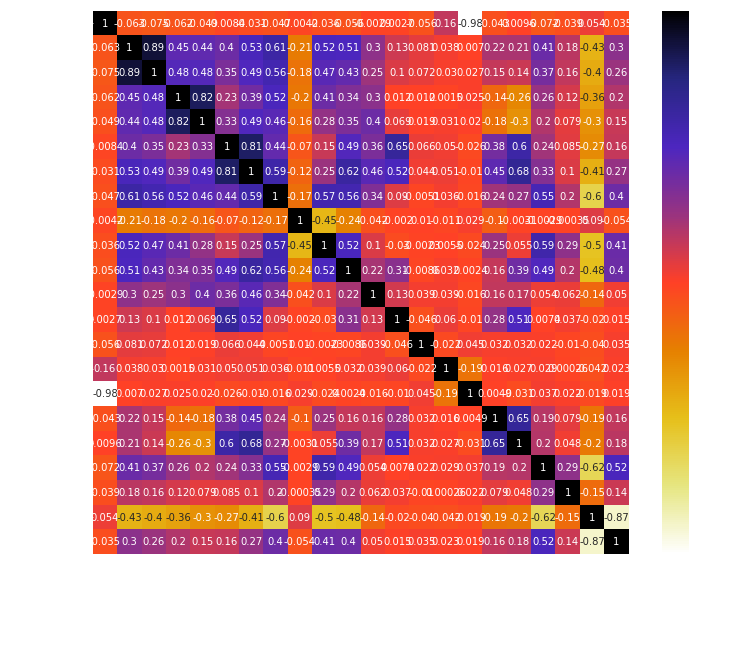

In [88]:
#Using Pearson Correlation
plt.figure(figsize=(12,10))
cor = X_train.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.CMRmap_r)
plt.show()

##### Got this function idea from krish nyak Machine learning tutorial

In [89]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything other feature

def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr


In [90]:
# checking the correlation of the features number
corr_features = correlation(X_train, 0.7)
len(set(corr_features))

5

In [91]:
print(corr_features)

{'feature05', 'feature07', 'feature16_good', 'feature20', 'feature02'}


In [92]:
# Removing the highly correlated features
X_train.drop(corr_features,axis=1)
X_test.drop(corr_features,axis=1)

,id,feature01,feature04,feature06,feature08,feature09,feature10,feature10.1,feature14,feature17,feature18,feature19,feature21,feature22,feature23,feature13_red,feature16_bad
1885,1886,2.0,894.0,6,5,5,1956,1,1,2,1,1,0,0,1956,1,0
2065,2066,2.0,671.0,11,5,4,1920,3,1,4,1,5,0,1087,1996,1,1
625,626,2.0,1562.0,5,6,8,1966,2,2,2,1,7,0,0,2008,1,0
2197,2198,1.0,768.0,5,5,5,1926,1,0,2,1,6,0,0,1950,1,1
1509,1510,1.0,941.0,7,4,6,1954,2,0,4,1,5,0,473,1972,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,152,1.0,988.0,5,5,5,1958,1,0,2,1,4,0,0,1958,1,1
1655,1656,2.0,780.0,7,5,5,1969,2,0,4,1,4,1,840,1969,1,1
2234,2235,0.0,936.0,6,5,7,1925,2,0,3,1,9,0,665,2003,1,1
1671,1672,2.0,864.0,5,4,6,1971,1,0,3,1,5,0,0,1971,1,1


# Preparing a DataFrame for model Analysis

In [93]:
models_e = pd.DataFrame(index=['RMSE','MAE'],columns=['NULL','MLR','KNN','LASSO','RANDOM_F'])
models_r = pd.DataFrame(index=['R2'],columns=['NULL','MLR','KNN','LASSO','RANDOM_F'])

In [94]:
models_r

,NULL,MLR,KNN,LASSO,RANDOM_F
R2,NaN,NaN,NaN,NaN,NaN


In [95]:
models_e

,NULL,MLR,KNN,LASSO,RANDOM_F
RMSE,NaN,NaN,NaN,NaN,NaN
MAE,NaN,NaN,NaN,NaN,NaN


# The Null Model

In [96]:
null_model = y_train.mean()
print(null_model)
models_e.loc['RMSE','NULL'] = mean_squared_error(y_pred=np.repeat(null_model,y_test.size),y_true=y_test,squared=False)
models_e.loc['MAE','NULL'] = mean_absolute_error(y_pred=np.repeat(null_model,y_test.size),y_true=y_test)
models_r.loc['R2','NULL'] = r2_score(y_pred=np.repeat(null_model,y_test.size),y_true=y_test)

181874.9833064082


# Multiple Linear Regression = MLR

In [97]:
mlr_model = LinearRegression()
mlr_model.fit(X_train,y_train)

LinearRegression()

## Prediction of Linear regression Score

In [98]:
mlr_model.score(X_test,y_test)

0.8901009510106237

Evaluate The Model

In [99]:
models_e.loc['RMSE','MLR'] = mean_squared_error(y_pred=mlr_model.predict(X_test),y_true=y_test,squared=False)
models_e.loc['MAE','MLR'] = mean_absolute_error(y_pred=mlr_model.predict(X_test),y_true=y_test)
models_r.loc['R2','MLR'] = r2_score(y_pred=mlr_model.predict(X_test),y_true=y_test)

# B.K-Nearest Neighbor Model

In [100]:
knn = KNeighborsRegressor(n_neighbors=5, weights='distance', metric='euclidean', n_jobs=-1)
knn.fit(X_train, y_train)

KNeighborsRegressor(metric='euclidean', n_jobs=-1, weights='distance')

Evaluate The Model

In [101]:
models_e.loc['RMSE','KNN'] = mean_squared_error(y_pred=knn.predict(X_test),y_true=y_test,squared=False)
models_e.loc['MAE','KNN'] = mean_absolute_error(y_pred=knn.predict(X_test),y_true=y_test)
models_r.loc['R2','KNN'] = r2_score(y_pred=knn.predict(X_test),y_true=y_test)

Prediction the B.K-Nearest Neighbor Score

In [102]:
knn.score(X_test, y_test)

0.7795072831241858

# C.Lasso

In [103]:
lasso = Lasso(alpha=0.0001)
lasso.fit(X_train,y_train)

C:\Users\susdh\anaconda3\envs\env1\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.914e+11, tolerance: 9.360e+08
  model = cd_fast.enet_coordinate_descent(


Lasso(alpha=0.0001)

Evaluate The Model

In [104]:
models_e.loc['RMSE','LASSO'] = mean_squared_error(y_pred=lasso.predict(X_test),y_true=y_test,squared=False)
models_e.loc['MAE','LASSO'] = mean_absolute_error(y_pred=lasso.predict(X_test),y_true=y_test)
models_r.loc['R2','LASSO'] = r2_score(y_pred=lasso.predict(X_test),y_true=y_test)

Prediction the C.Lasso Score

In [105]:
lasso.score(X_test,y_test)

0.8901011875486768

# Random Forest

In [106]:
r_f_model = RandomForestRegressor(n_estimators=50, max_depth=16, random_state=55, n_jobs=-1)
r_f_model.fit(X_train, y_train)

RandomForestRegressor(max_depth=16, n_estimators=50, n_jobs=-1, random_state=55)

Evaluate The Model

In [107]:
models_e.loc['RMSE','RANDOM_F'] = mean_squared_error(y_pred=r_f_model.predict(X_test),y_true=y_test,squared=False)
models_e.loc['MAE','RANDOM_F'] = mean_absolute_error(y_pred=r_f_model.predict(X_test),y_true=y_test)
models_r.loc['R2','RANDOM_F'] = r2_score(y_pred=r_f_model.predict(X_test),y_true=y_test)

Prediction the Random Forest Model Score

In [108]:
r_f_model.score(X_test, y_test)

0.8987711146459731

## Visuazilation of Error Metrics

In [109]:
models_e

,NULL,MLR,KNN,LASSO,RANDOM_F
RMSE,73110.28925,24236.138598,34329.19224,24236.112516,23260.480811
MAE,56417.861162,17456.022474,23423.456797,17455.995602,16009.393234


In [110]:
models_r

,NULL,MLR,KNN,LASSO,RANDOM_F
R2,-0.000055,0.890101,0.779507,0.890101,0.898771


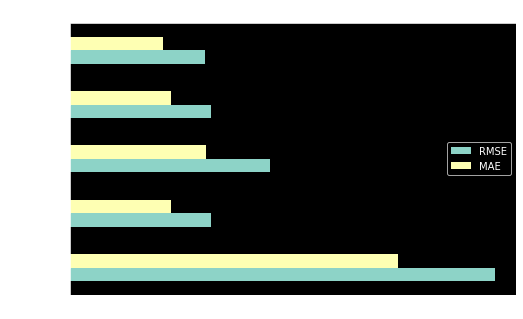

In [111]:
# plot the model evaluation metrics
fig, ax = plt.subplots(figsize=(8,5))
models_e.T.plot(kind='barh',ax=ax)
ax.set_title('Mean Error Metrics for Regression Models')
ax.legend(loc=5);

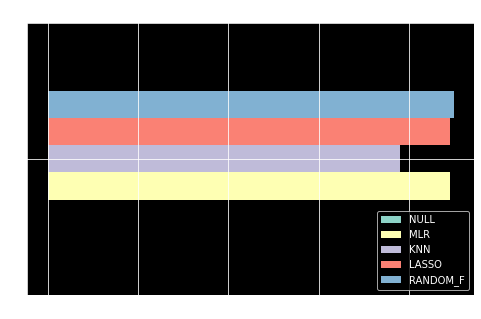

In [112]:
# plot the r2 score 
fig, ax = plt.subplots(figsize=(8,5))
models_r.plot(kind='barh',ax=ax)
ax.set_title('Mean Error Metrics for Regression Models')
ax.grid();

# Comparing Models with K_fold Cross_ Validation

In [113]:
# Creating data frame for cross validation score
models_cross_val = pd.DataFrame(index=['SCORE'],columns=['MLR','KNN','LASSO','RANDOM_F'])

In [114]:
models_cross_val

,MLR,KNN,LASSO,RANDOM_F
SCORE,NaN,NaN,NaN,NaN


In [115]:
# Linear Regression with k_ Fold and evaluate the score
MLR= cross_val_score(LinearRegression(),X_train,y_train,cv=5).mean()
models_cross_val.loc['SCORE','MLR'] = MLR

In [116]:
# KNN Regression with k_ Fold and evaluate the score
KNN = cross_val_score(KNeighborsRegressor(n_neighbors=5, weights='distance', metric='euclidean', n_jobs=-1),X_train,y_train,cv=5).mean()
models_cross_val.loc['SCORE','KNN'] = KNN

In [117]:
# Lasso Regression with k_ Fold and evaluate the score
LASSO = cross_val_score(Lasso(alpha=0.0001),X_train,y_train,cv=5).mean()
models_cross_val.loc['SCORE','LASSO'] = LASSO

C:\Users\susdh\anaconda3\envs\env1\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.584e+11, tolerance: 7.300e+08
  model = cd_fast.enet_coordinate_descent(
C:\Users\susdh\anaconda3\envs\env1\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.601e+11, tolerance: 7.415e+08
  model = cd_fast.enet_coordinate_descent(
C:\Users\susdh\anaconda3\envs\env1\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Du

In [118]:
# Random Forest Regression with k_ Fold and evaluate the score
RANDOM_F = cross_val_score(RandomForestRegressor(n_estimators=50, max_depth=16, random_state=55, n_jobs=-1),X_train,y_train,cv=5).mean()
models_cross_val.loc['SCORE','RANDOM_F'] = RANDOM_F

In [119]:
models_cross_val

,MLR,KNN,LASSO,RANDOM_F
SCORE,0.869546,0.776004,0.869546,0.877457


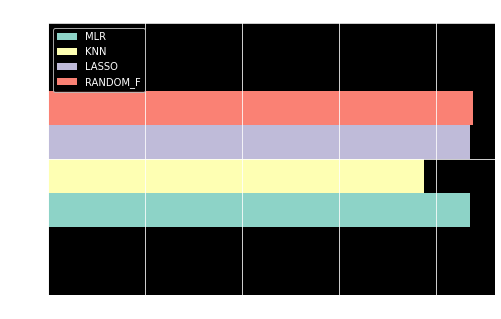

In [120]:
# plot the cross validation score
fig, ax = plt.subplots(figsize=(8,5))
models_cross_val.plot(kind='barh',ax=ax)
ax.set_title('Best Models by using Cross Validation and Parameter Tuning')
ax.legend(loc=2)
ax.grid();

 In conclusion, the best model is Random Forest Regression with k_ Fold and evaluate the score.
 before feature engineering and after feature engineering the score is the very deference between the two.
 Outliers are removed and the data is normalized also imporved the score.